# Model Training by keras

## Imports

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"

from utils import data_importer
from utils import model as md
from utils import unet, fcrn, metrics

import tensorflow as tf
tf.config.optimizer.set_jit(True)
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import numpy as np

# from tensorflow.python.client import device_lib
# device_lib.list_local_devices()

Don't pre-allocate memory; allocate as-needed

In [2]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
K.set_session(tf.Session(config=config))

## Imporing Dataset

### Datasets settings

In [3]:
COMMON_SETTING = {
    'table_address' : "./utils/labels.csv",
    'batch_size' : 2, 
    'output_shape' : (480, 640),
    'data_type' : 'float32',
    'feature_types' : ['image', 'segmentation' ],
    'label_types' : ['depth'],
    'class_ids' : data_importer.COMMON_LABEL_IDS.copy()
}

# SYNTHIA_SF_SETTINGS 
address = 'C:/Users/KSTATION/jupyter/SYNTHIA-SF'
dsg = data_importer.SynthiaSf
usage_range_train = (0, 1)
usage_range_validation = (0.75, 1)
usage_range_test = (0.75, 1)
    
# # VIPER_SETTINGS 
# address = 'D:/Library/Datasets/(GTA-V)Playing for Benchmarks'
# dsg = data_importer.VIPER
# usage_range_train = (0, 1)
# usage_range_validation = (0, 1)
# usage_range_test = (0, 1)

# # MAPILLARY_SETTINGS 
# address = 'D:/Library/Datasets/mapillary-vistas-dataset_public_v1.1'
# dsg = data_importer.MAPILLARY
# usage_range_train = (0, 1)
# usage_range_validation = (0, 1)
# usage_range_test = (0, 1)

# # CITYSCAPES_SETTINGS 
# address = 'D:/Library/Datasets/cityscapes'
# dsg = data_importer.CITYSCAPES
# usage_range_train = (0, 1)
# usage_range_validation = (0, 1)
# usage_range_test = (0, 1)


### Creating dataset generator

In [4]:
dsg_train = dsg(**COMMON_SETTING,
                dataset_dir=address,
                usage='train',
                usage_range=usage_range_train)

dsg_validation = dsg(**COMMON_SETTING,
                    dataset_dir=address,
                    usage='validation',
                    usage_range=usage_range_validation)
# dsg_test = dsg(**COMMON_SETTING,
#                     dataset_dir=address,
#                     usage='test',
#                     usage_range=usage_range_test)

### Preview of dataset

In [5]:
preview = iter(dsg_train)

In [6]:
feature_list, label_list=next(preview)

F:\Anaconda3\envs\tf\lib\site-packages\skimage\util\dtype.py:135: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))
F:\Anaconda3\envs\tf\lib\site-packages\skimage\util\dtype.py:135: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))


In [7]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

from utils import visualizer as vis

options=['Simple plot', 'RGB point cloud', 'Segmented point cloud']

def f(x):
    vis.draw_samples(feature_list, label_list, x-1,
                     feature_types=COMMON_SETTING['feature_types'], 
                     label_types=COMMON_SETTING['label_types'])
    
def f2(x):
    vis.draw_point_cloud(label_list[0][x-1], feature_list[0][x-1])
    
def view_type_selector(y):
    if y == options[0]:
        interact(f, 
                 x=widgets.IntSlider(description="Sample Num", min=1, max=dsg_train.batch_size, continuous_update=False))
    if y == options[1]:
        interact_manual(f2,
                        x=widgets.IntSlider(description="Sample Num", min=1, max=dsg_train.batch_size, continuous_update=False))
    else:
        print(y)
        
x=interact_manual(view_type_selector, y=widgets.Dropdown(description="View type:", options=options))

interactive(children=(Dropdown(description='View type:', options=('Simple plot', 'RGB point cloud', 'Segmented…

## Building the Model

In [8]:
tf.keras.backend.set_floatx('float32')
inputs = tf.keras.Input(shape=(480,640,3))
# model = md.deep_lab_v3(inputs=inputs, output_stride = 32)
# model = unet.model(img_shape=(480,640,3),num_of_class=19)
# model = fcrn.model(img_shape=(480,640,3))
model = fcrn.model_rgb_seg(rgb_shape=(480,640,3), seg_shape=(480, 640, 19))

# model.summary()

W1010 20:25:16.332378  4604 deprecation.py:506] From F:\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\ops\init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [9]:
# model = tf.keras.utils.multi_gpu_model(model, gpus=2)

## for segmetation training
# model.compile(optimizer='adam', loss=metrics.bce_dice_loss_nb, metrics=[metrics.dice_loss_nb])

## for segmetation evaluating: IUO class 
# class_list = []
# for i, label_id in enumerate(data_importer.COMMON_LABEL_IDS):
#     class_list.append(dsg_validation.label_table.name[label_id].replace(' ', '_').replace('(', '').replace(')', ''))
    
# metric_list = metrics.class_IOU_list(class_list)
# model.compile(optimizer='adam', loss=metrics.mean_IOU_loss, metrics=metric_list) 


## for depth trainig
model.compile(optimizer="adam", loss=tf.keras.losses.MSE, metrics=['accuracy'])

## Training

In [10]:
address = './log/depth/input_concatenate/'

In [ ]:
import os
try:
    os.makedirs(address + 'plugins/profile/')
except FileExistsError:
    pass

train_step = np.int((dsg_train.end_index - dsg_train.start_index)/COMMON_SETTING['batch_size'])
validation_steps = np.int(dsg_validation.end_index - dsg_validation.start_index/COMMON_SETTING['batch_size'])
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(address + "my_keras_model.h5"),
    tf.keras.callbacks.EarlyStopping(patience=4, monitor='val_loss'),
    # Write TensorBoard logs to `./logs` directory
    tf.keras.callbacks.TensorBoard(log_dir=address)
]
history = model.fit_generator(dsg_train, steps_per_epoch=train_step, epochs=10, callbacks=callbacks, 
                    validation_data=dsg_validation, validation_steps=validation_steps)

Epoch 1/10


F:\Anaconda3\envs\tf\lib\site-packages\skimage\util\dtype.py:135: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))
F:\Anaconda3\envs\tf\lib\site-packages\skimage\util\dtype.py:135: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))
F:\Anaconda3\envs\tf\lib\site-packages\skimage\util\dtype.py:135: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))


2223/2223 [==============================] - 4928s 2s/step - loss: 88020.1817 - acc: 0.0000e+00 - val_loss: 6448.3519 - val_acc: 0.0000e+00
Epoch 2/10
2223/2223 [==============================] - 4831s 2s/step - loss: 5767.3528 - acc: 0.0000e+00 - val_loss: 3419.5126 - val_acc: 0.0000e+00
Epoch 3/10
2223/2223 [==============================] - 29821s 13s/step - loss: 3137.8681 - acc: 0.0000e+00 - val_loss: 3040.4069 - val_acc: 0.0000e+00
Epoch 4/10
2223/2223 [==============================] - 4818s 2s/step - loss: 2606.1440 - acc: 0.0000e+00 - val_loss: 2673.6017 - val_acc: 0.0000e+00
Epoch 5/10
2223/2223 [==============================] - 4817s 2s/step - loss: 2378.5512 - acc: 0.0000e+00 - val_loss: 2513.9336 - val_acc: 0.0000e+00
Epoch 6/10
2223/2223 [==============================] - 4842s 2s/step - loss: 2226.3765 - acc: 0.0000e+00 - val_loss: 2558.5823 - val_acc: 0.0000e+00
Epoch 7/10
2223/2223 [==============================] - 4909s 2s/step - loss: 2092.7610 - acc: 0.0000e+00 - 

# Evaluatation and Prediction

In [ ]:
ref_net_name = 'VIPER'

In [11]:
# model.load_weights('./log/unet/' + ref_net_name + '/my_keras_model.h5')
model.load_weights(address +'my_keras_model.h5')

In [26]:
steps = dsg_validation.size/dsg_validation.batch_size
result = model.evaluate_generator(dsg_validation, steps=steps, verbose=1)

   23/49813 [..............................] - ETA: 3:56:13 - loss: 4.5632 - dice_loss_nb: 0.0689

KeyboardInterrupt: 

In [176]:
for i in result:
    print(i)

 0.6815247618699527
 0.0025633804
 0.21344142
 0.10106235
 0.35188216
 0.02016269
 5.9991225e-06
 0.5879997
 1.0240624e-07
 0.05992898
 0.03529596
 0.02123247
 0.00085794233
 8.179724e-06
 0.0016308313
 0.43439138
 1.7719894e-06
 1.3390713e-06
 0.00032039476
 1.5815515e-07


## Plot

In [12]:
dsg_validation.index= 59
preview = iter(dsg_validation)
feature_list, label_list=next(preview)
model.evaluate(feature_list, label_list)

2/2 [==============================] - 7s 3s/sample - loss: 2265.7603 - acc: 0.0000e+00


[2265.76025390625, 0.0]

In [13]:
predict=model.predict(feature_list,steps=1)

In [14]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

from utils import visualizer as vis

options=['Simple plot', 'RGB point cloud', 'Segmented point cloud']

def f(x):
    vis.draw_samples(feature_list, label_list, x-1,
                     feature_types=COMMON_SETTING['feature_types'], 
                     label_types=COMMON_SETTING['label_types'])
    
def f2(x):
    vis.draw_point_cloud(label_list[0][x-1], feature_list[0][x-1])
    
def view_type_selector(y):
    if y == options[0]:
        interact(f, 
                 x=widgets.IntSlider(description="Sample Num", min=1, max=dsg_train.batch_size, continuous_update=False))
    if y == options[1]:
        interact_manual(f2,
                        x=widgets.IntSlider(description="Sample Num", min=1, max=dsg_train.batch_size, continuous_update=False))
    else:
        print(y)
        
x=interact_manual(view_type_selector, y=widgets.Dropdown(description="View type:", options=options))

interactive(children=(Dropdown(description='View type:', options=('Simple plot', 'RGB point cloud', 'Segmented…

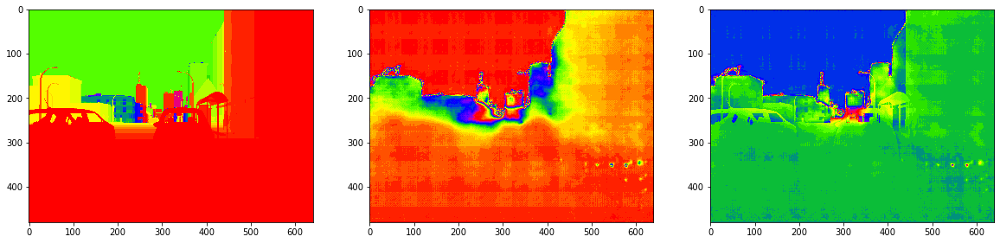

In [15]:

plt.figure(figsize=(20,20))
plt.set_cmap('prism')
plt.subplot(1,3,1)
plt.imshow(label_list[0][0, :, :, 0])
plt.subplot(1,3,2)
plt.imshow(predict[0, :, :, 0])
plt.subplot(1,3,3)
plt.imshow(label_list[0][0, :, :, 0]-predict[0, :, :, 0])


In [19]:
vis.draw_point_cloud(label_list[0][0], predict[0, :, :, 0])

In [20]:
import open3d as o3d

In [22]:
image = label_list[0][0]
depth = predict[0, :, :, 0]

In [23]:
a = o3d.geometry.Image(image)  #pylint: disable=no-member
b = o3d.geometry.Image(depth)  #pylint: disable=no-member
rgbd_image = o3d.geometry.RGBDImage.create_from_color_and_depth(a, b)  #pylint: disable=no-member
pcd = o3d.geometry.PointCloud.create_from_rgbd_image(  #pylint: disable=no-member
    rgbd_image,
    o3d.camera.PinholeCameraIntrinsic(  #pylint: disable=no-member
        o3d.camera.PinholeCameraIntrinsicParameters.PrimeSenseDefault))  #pylint: disable=no-member

rgb_vector = np.reshape(image, [-1, 3])
pcd.colors = o3d.utility.Vector3dVector(rgb_vector)  #pylint: disable=no-member
o3d.visualization.draw_geometries([pcd])  #pylint: disable=no-member

# Plotly

In [93]:
import pandas as pd
import plotly.express as px

In [94]:
import plotly

In [95]:
deptmap = label_list[0][0][:,:,0]

In [113]:
x_l = []
y_l = []
z_l = []
c_l = []
s_l = []
for x in range(deptmap.shape[0]):
    for y in range(deptmap.shape[1]):
        x_l.append(x)
        y_l.append(y)
        z_l.append(deptmap[x,y]*1000)
        c_l.append(deptmap[x,y]*1000)
        s_l.append(0.1)
df = pd.DataFrame({'x':x_l, 'y':y_l, 'z':z_l,  'color':c_l, 'size':s_l})

In [98]:
fig = px.scatter(df, x='y', y='x',color='color', size='size', hover_name='color',  render_mode='webgl')

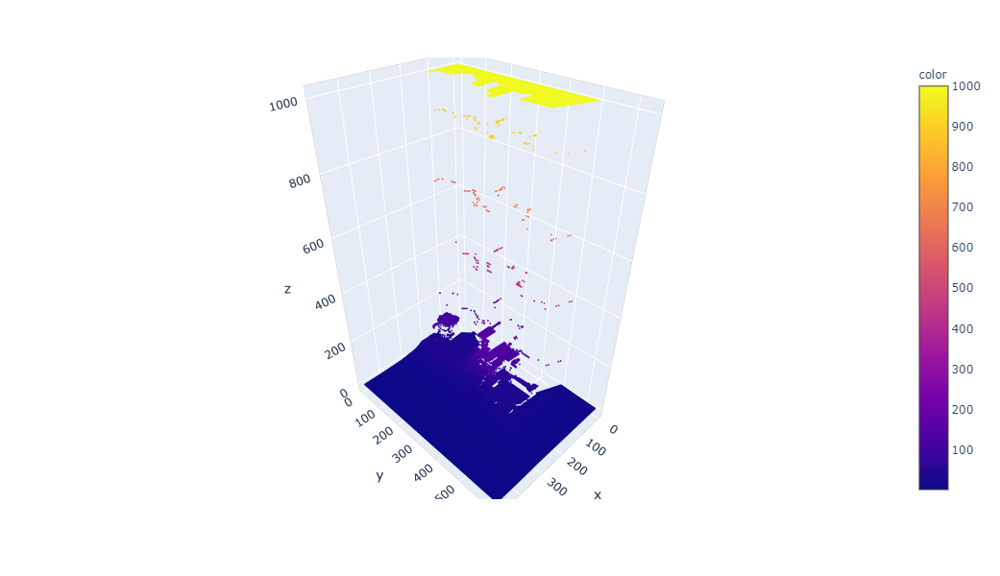

In [119]:
# iris = px.data.iris()
fig = px.scatter_3d(df, x='x', y='y', z='z', color='color', size='size')
# fig = px.scatter(df, x='y', y='x',color='color', size='size', hover_name='color',  render_mode='webgl')
fig.data[0].marker.line.width=0
fig.data[0].marker.size = 1
fig.layout.yaxis.autorange='reversed'
fig.show()

In [125]:
plotly.io.write_html(fig, file="m.html")